<a href="https://colab.research.google.com/github/mbcruz96/BLIP2/blob/main/BLIP2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Dependencies and Libraries

In [8]:
!pip install salesforce-lavis
!pip install transformers
!pip install peft
!python -m pip install diffusers==0.14.0
!pip install open3d

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 30.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.6/13.6 MB 92.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.6/44.6 kB 7.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 235.4/235.4 kB 31.8 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.4/53.4 kB 9.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.2/42.2 kB 7.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 14.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 47.8/47.8 MB 35.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 204.2/204.2 kB 31.2 MB/s eta 0:00:00
     ━━━━━━━

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 190.9/190.9 kB 4.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 280.0/280.0 kB 39.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 737.4/737.4 kB 16.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 399.7/399.7 MB 2.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.2/10.2 MB 107.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.4/139.4 kB 22.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 98.2 MB/s eta 0:00:00
  Attempting uninstall: widgetsnbextension
    Found existing installation: widgetsnbextension 3.6.6
    Uninstalling widgetsnbextension-3.6.6:
      Successfully uninstalled widgetsnbextension-3.6.6
  Attempting uninstall: ipywidgets
    Found existing installation: ipywidgets 7.7.1
    Uninstalling ipywidgets-7.7.1:
      Successfully uninstalled ipywidgets-7.7.1


In [9]:
import torch
import lavis
from lavis.models import model_zoo, load_model_and_preprocess
from lavis.datasets.builders import dataset_zoo, load_dataset
import peft
import diffusers
from diffusers import models
from diffusers.models import attention
from diffusers.models.cross_attention import CrossAttention
import open3d
from PIL import Image
import os

#Downloading Data

In [4]:
!git clone https://github.com/salesforce/LAVIS.git
!cd LAVIS
!pip install -e .

Cloning into 'LAVIS'...
remote: Enumerating objects: 7746, done.
remote: Counting objects: 100% (2040/2040), done.
remote: Compressing objects: 100% (313/313), done.
remote: Total 7746 (delta 1775), reused 1727 (delta 1727), pack-reused 5706
Receiving objects: 100% (7746/7746), 85.71 MiB | 15.85 MiB/s, done.
Resolving deltas: 100% (5025/5025), done.
Obtaining file:///content
ERROR: file:///content does not appear to be a Python project: neither 'setup.py' nor 'pyproject.toml' found.


In [18]:
img1_raw = Image.open('animals.jpg').convert('RGB')
img2_raw = Image.open('hills.jpg').convert('RGB')
img3_raw = Image.open('lake.jpg').convert('RGB')
img4_raw = Image.open('lovers.jpg').convert('RGB')
img5_raw = Image.open('mandog.jpg').convert('RGB')

In [12]:
os.environ['RANK'] = '0'
os.environ['WORLD_SIZE'] = '1'
os.environ['MASTER_ADDR'] = 'localhost'
os.environ['MASTER_PORT'] = '12355'

torch.distributed.init_process_group("nccl", init_method="env://")

#Exploration

In [46]:
print(model_zoo)
print(dataset_zoo.get_names())

Architectures                  Types
albef_classification           ve
albef_feature_extractor        base
albef_nlvr                     nlvr
albef_pretrain                 base
albef_retrieval                coco, flickr
albef_vqa                      vqav2
alpro_qa                       msrvtt, msvd
alpro_retrieval                msrvtt, didemo
blip_caption                   base_coco, large_coco
blip_classification            base
blip_feature_extractor         base
blip_image_text_matching       base, large
blip_nlvr                      nlvr
blip_pretrain                  base
blip_retrieval                 coco, flickr
blip_vqa                       vqav2, okvqa, aokvqa
blip2_opt                      pretrain_opt2.7b, pretrain_opt6.7b, caption_coco_opt2.7b, caption_coco_opt6.7b
blip2_t5                       pretrain_flant5xl, pretrain_flant5xl_vitL, pretrain_flant5xxl, caption_coco_flant5xl
blip2_feature_extractor        pretrain, pretrain_vitL, coco
blip2                      

#Image-Text Retrieval

In [13]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
itr_model, itr_img_processor, itr_txt_processor = load_model_and_preprocess(name='blip2', model_type='coco', is_eval=True, device=device)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

100%|██████████| 1.89G/1.89G [01:34<00:00, 21.4MB/s]


Position interpolate from 16x16 to 26x26


model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

100%|██████████| 4.37G/4.37G [03:33<00:00, 22.0MB/s]


animals fighting


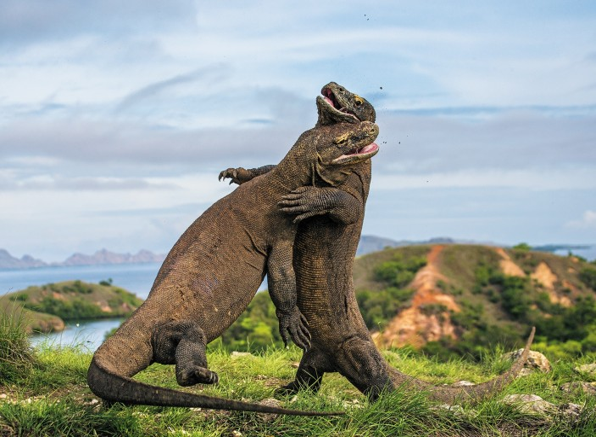

In [21]:
cap1 = "animals fighting"
print(cap1)
display(img1_raw.resize((596, 437)))

beautiful hill landscape


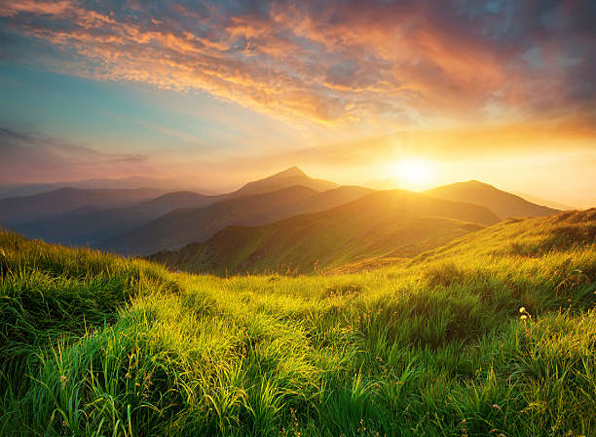

In [20]:
cap2 = "beautiful hill landscape"
print(cap2)
display(img2_raw.resize((596, 437)))

a chinese restaurant


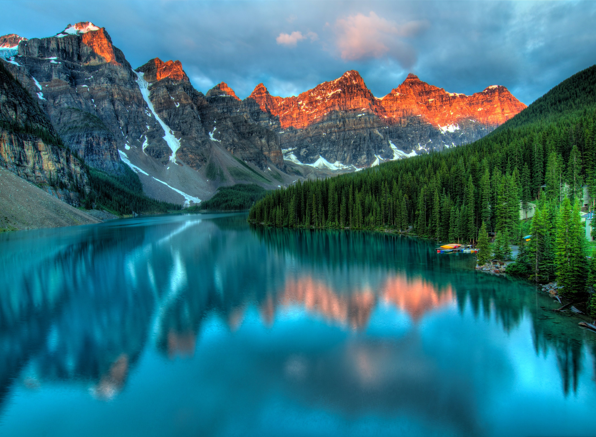

In [22]:
cap3 = "a chinese restaurant"
print(cap3)
display(img3_raw.resize((596, 437)))

lovers holding hands


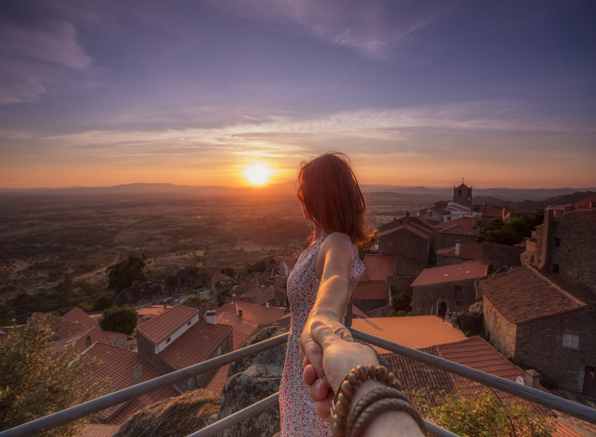

In [23]:
cap4 = "lovers holding hands"
print(cap4)
display(img4_raw.resize((596, 437)))

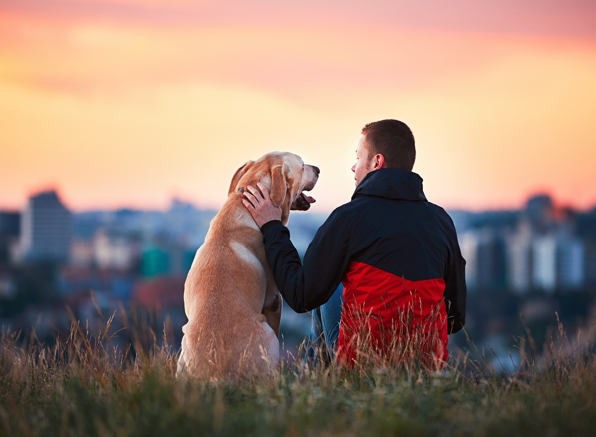

In [24]:
cap5 = "a dark scary cave"
display(img5_raw.resize((596, 437)))

In [25]:
img1 = itr_img_processor["eval"](img1_raw).unsqueeze(0).to(device)
cap1 = itr_txt_processor["eval"](cap1)

img2 = itr_img_processor["eval"](img2_raw).unsqueeze(0).to(device)
cap2 = itr_txt_processor["eval"](cap2)

img3 = itr_img_processor["eval"](img3_raw).unsqueeze(0).to(device)
cap3 = itr_txt_processor["eval"](cap3)

img4 = itr_img_processor["eval"](img4_raw).unsqueeze(0).to(device)
cap4 = itr_txt_processor["eval"](cap4)

img5 = itr_img_processor["eval"](img5_raw).unsqueeze(0).to(device)
cap5 = itr_txt_processor["eval"](cap5)

In [49]:
itm_output = itr_model.
#itm_scores = torch.nn.functional.softmax(itm_output, dim=1)
print(f'The image and text are matched with a probability of {itm_scores[:, 1].item():.3%}')

/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:429: UserWarning: torch.utils.checkpoint: please pass in use_reentrant=True or use_reentrant=False explicitly. The default value of use_reentrant will be updated to be False in the future. To maintain current behavior, pass use_reentrant=True. It is recommended that you use use_reentrant=False. Refer to docs for more details on the differences between the two variants.
  warnings.warn(


IndexError: Dimension out of range (expected to be in range of [-1, 0], but got 1)

#Captioning

In [5]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model, img_processor, txt_processor = load_model_and_preprocess(name='blip_caption', model_type='base_coco', is_eval=True, device=device)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


In [7]:
img1 = img_processor["eval"](img1_raw).unsqueeze(0).to(device)

img2 = img_processor["eval"](img2_raw).unsqueeze(0).to(device)

img3 = img_processor["eval"](img3_raw).unsqueeze(0).to(device)

img4 = img_processor["eval"](img4_raw).unsqueeze(0).to(device)

img5 = img_processor["eval"](img5_raw).unsqueeze(0).to(device)

['a couple of large animals standing on top of a lush green field']


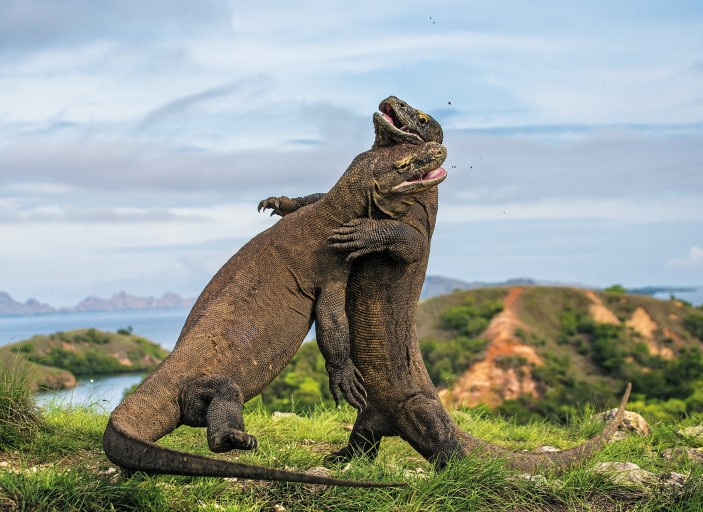

In [11]:
output = model.generate({"image": img1})
print(output)
display(img1_raw)

['the sun is setting over a grassy hill']


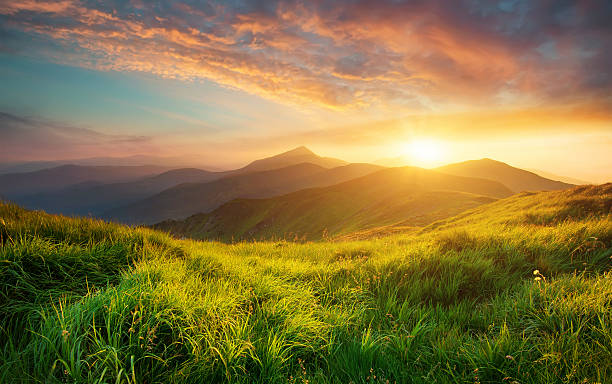

In [12]:
output = model.generate({"image": img2})
print(output)
display(img2_raw)

['a lake surrounded by mountains under a cloudy sky']


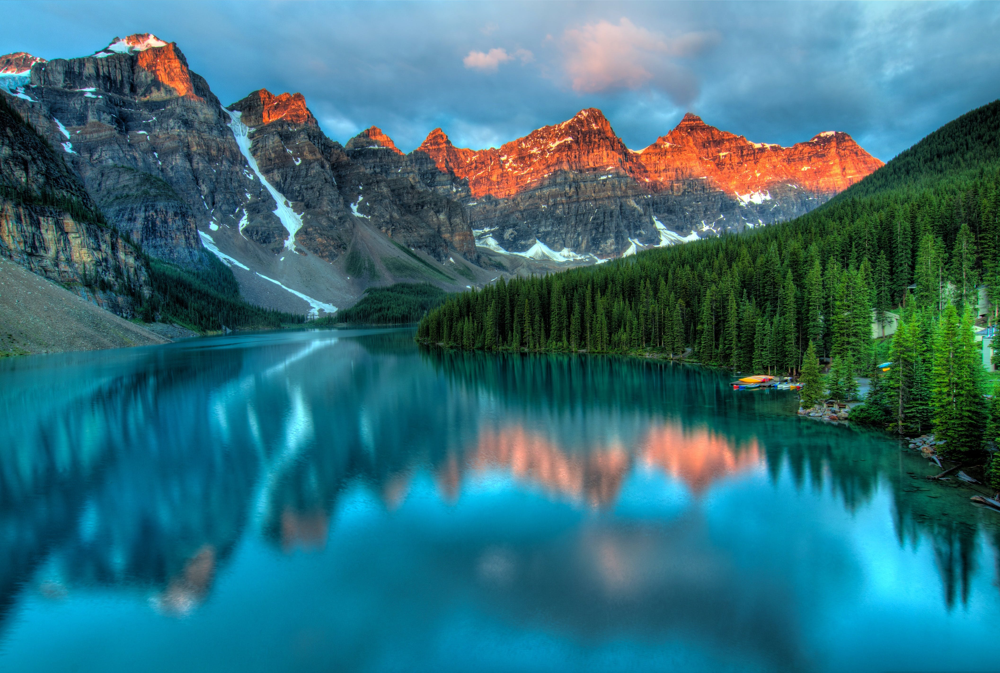

In [13]:
output = model.generate({"image": img3})
print(output)
display(img3_raw)

['a woman holding the hand of a man on top of a hill']


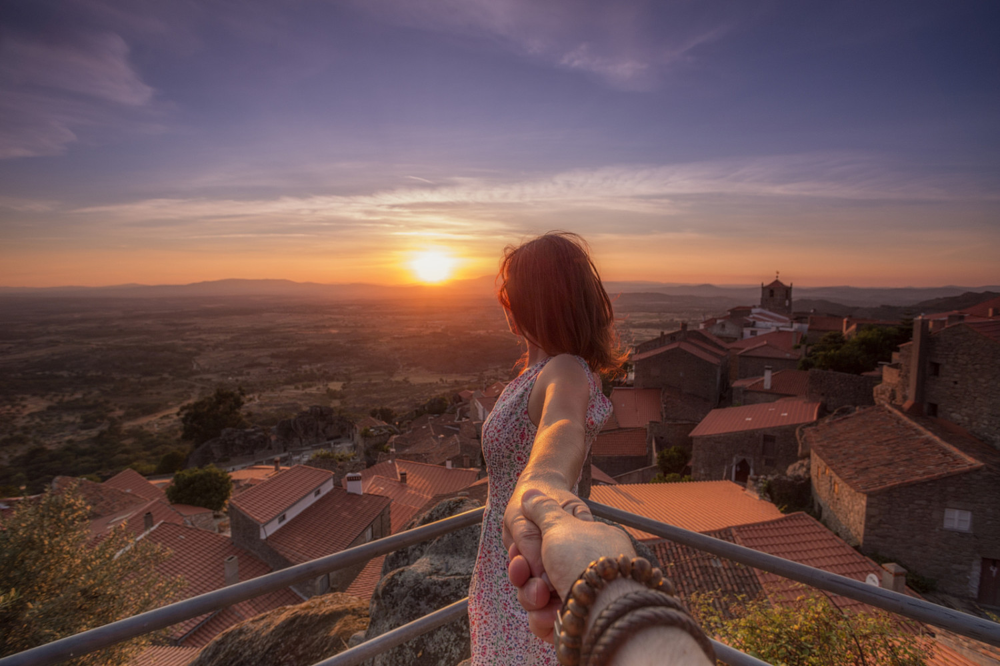

In [14]:
output = model.generate({"image": img4})
print(output)
display(img4_raw)

['a man and his dog are sitting in a field']


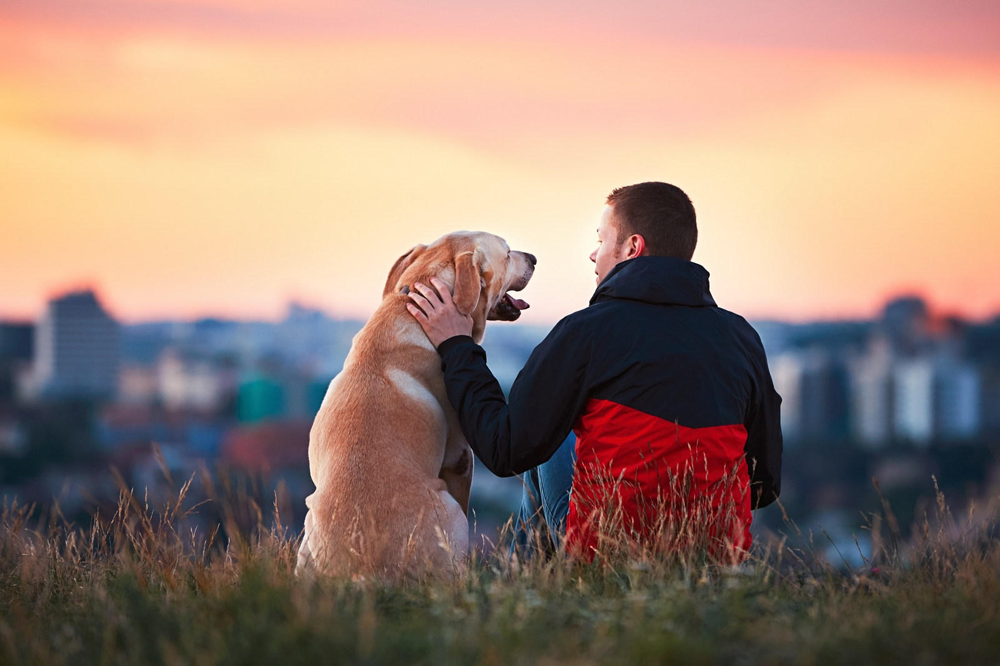

In [15]:
output = model.generate({"image": img5})
print(output)
display(img5_raw)

#VQA

In [16]:
vqa_model, vqa_img_processor, vqa_txt_processor = load_model_and_preprocess(name="blip_vqa", model_type="vqav2", is_eval=True, device=device)

100%|██████████| 1.35G/1.35G [00:07<00:00, 189MB/s]


In [17]:
img1_raw = Image.open('animals.jpg').convert('RGB')
img2_raw = Image.open('hills.jpg').convert('RGB')
img3_raw = Image.open('lake.jpg').convert('RGB')
img4_raw = Image.open('lovers.jpg').convert('RGB')
img5_raw = Image.open('mandog.jpg').convert('RGB')

In [18]:
cap1 = "What animals are in this photo?"
cap2 = "What is in the background of this photo?"
cap3 = "Where was this photo taken?"
cap4 = "What are the people in the photo feeling?"
cap5 = "What is this a photo of?"

In [19]:
img1 = vqa_img_processor["eval"](img1_raw).unsqueeze(0).to(device)
cap1 = vqa_txt_processor["eval"](cap1)

img2 = vqa_img_processor["eval"](img2_raw).unsqueeze(0).to(device)
cap2 = vqa_txt_processor["eval"](cap2)

img3 = vqa_img_processor["eval"](img3_raw).unsqueeze(0).to(device)
cap3 = vqa_txt_processor["eval"](cap3)

img4 = vqa_img_processor["eval"](img4_raw).unsqueeze(0).to(device)
cap4 = vqa_txt_processor["eval"](cap4)

img5 = vqa_img_processor["eval"](img5_raw).unsqueeze(0).to(device)
cap5 = vqa_txt_processor["eval"](cap5)

what animals are in this photo?
['elephants']


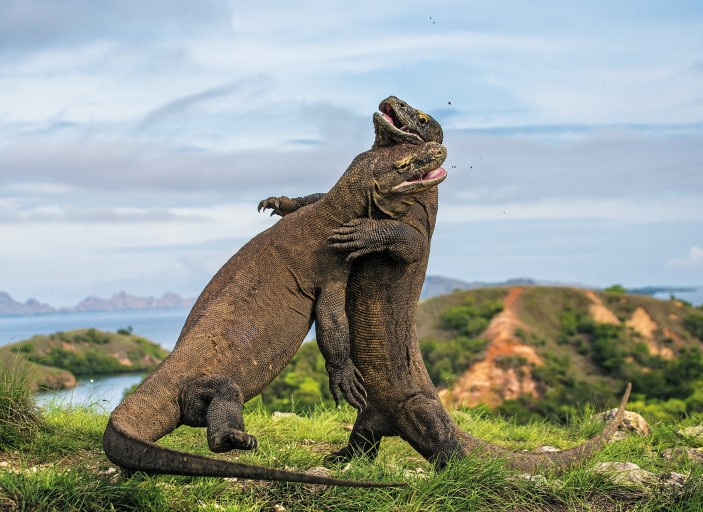

In [23]:
output = vqa_model.predict_answers(samples={"image": img1, "text_input": cap1}, inference_method="generate")
print(cap1)
print(output)
display(img1_raw)

what is in the background of this photo?
['mountains']


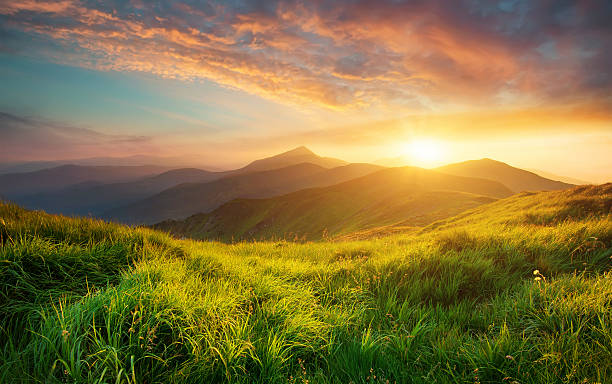

In [24]:
output = vqa_model.predict_answers(samples={"image": img2, "text_input": cap2}, inference_method="generate")
print(cap2)
print(output)
display(img2_raw)

where was this photo taken?
['in mountains']


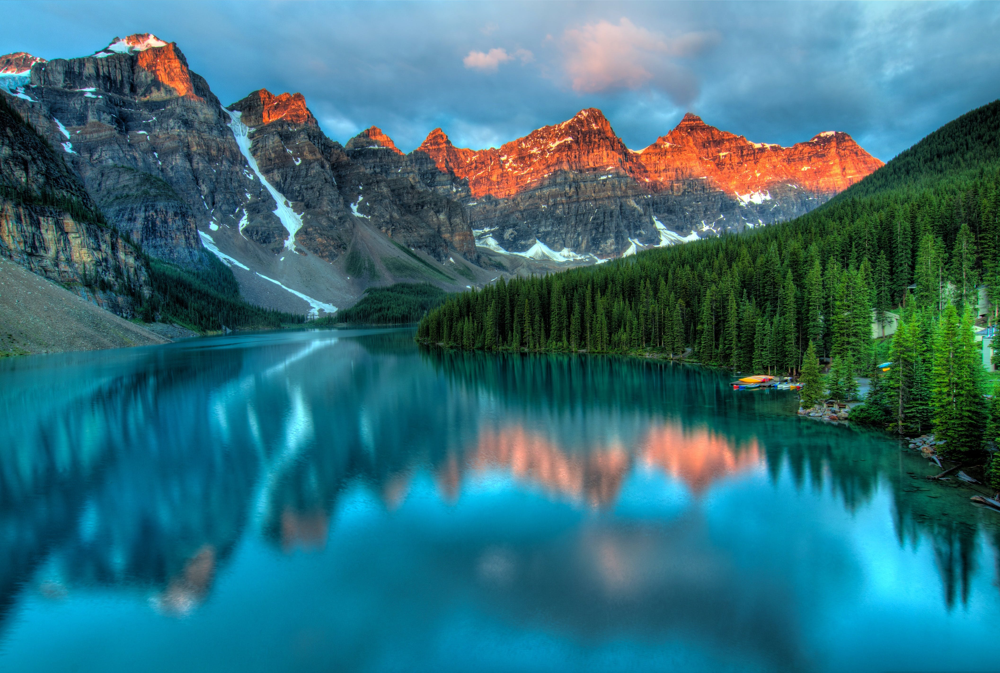

In [25]:
output = vqa_model.predict_answers(samples={"image": img3, "text_input": cap3}, inference_method="generate")
print(cap3)
print(output)
display(img3_raw)

what are the people in the photo feeling?
['happy']


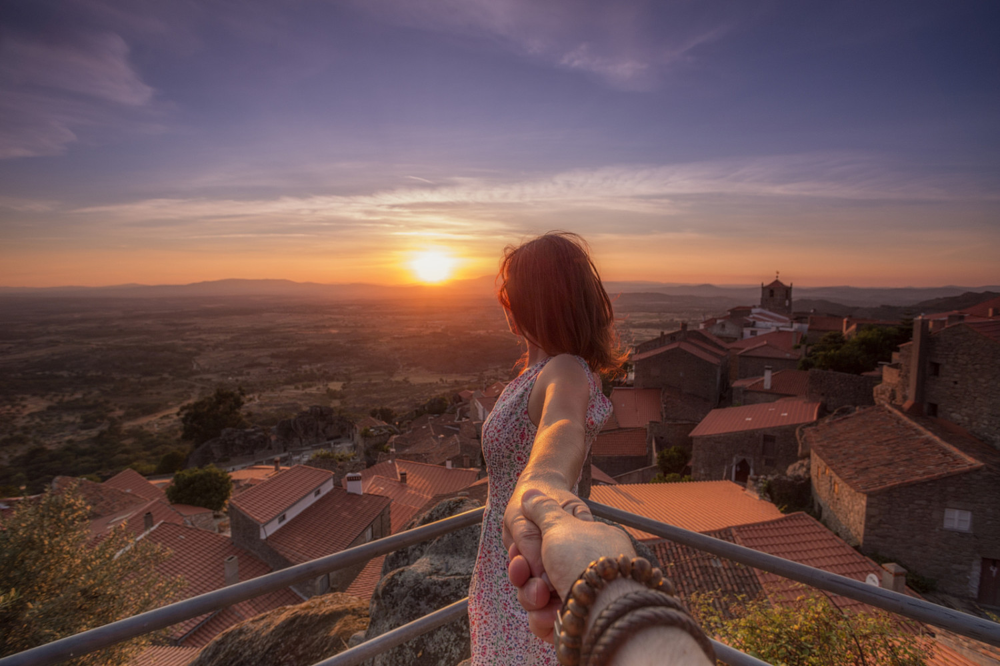

In [26]:
output = vqa_model.predict_answers(samples={"image": img4, "text_input": cap4}, inference_method="generate")
print(cap4)
print(output)
display(img4_raw)

what is this a photo of?
['man and dog']


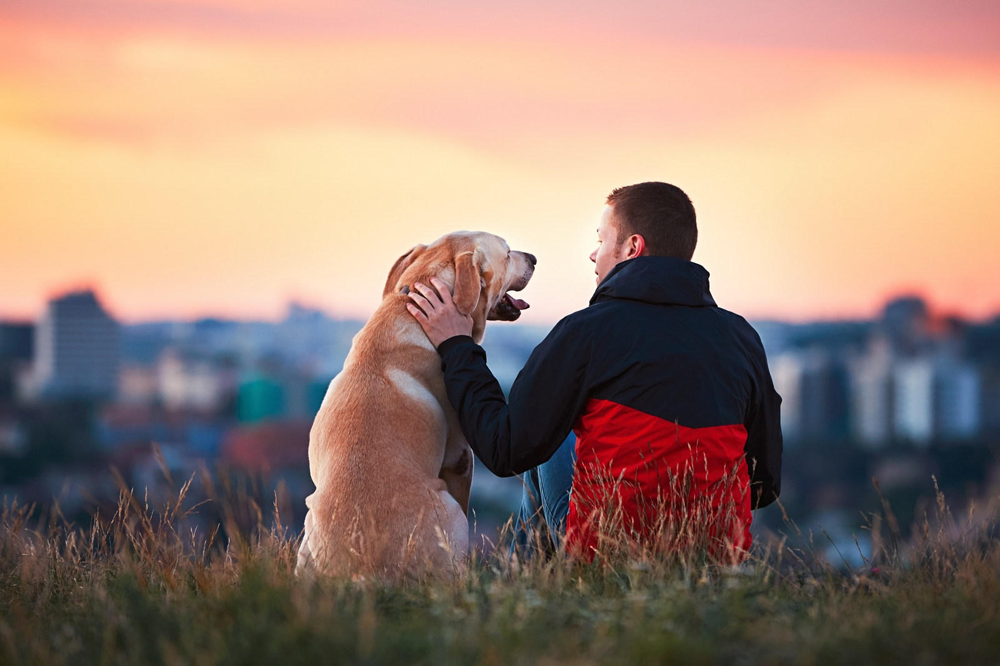

In [27]:
output = vqa_model.predict_answers(samples={"image": img5, "text_input": cap5}, inference_method="generate")
print(cap5)
print(output)
display(img5_raw)